In [ ]:
import h5py
import os
import pandas as pd
import numpy as np

# Directory containing the EEG files
data_dir = r"C:\Users\RAZER\Documents\Datasets\NYC\EEG_250517\EEG\EEG"

# Corrected list of .set files
set_files = [
    "28-2010-anest 20100824 092.004.set",
    "28-2010-anest 20100824 092.011.set",
    "28-2010-anest 20100824 092.016.set",
    "28-2010-anest 20100824 092.029.set"
]

# Creating an empty DataFrame to store all merged data
merged_data = pd.DataFrame()

# Extracting EEG signals and merging with events
for set_file in set_files:
    set_path = os.path.join(data_dir, set_file)
    fdt_file = set_file.replace(".set", ".fdt")
    fdt_path = os.path.join(data_dir, fdt_file)
    
    try:
        with h5py.File(set_path, 'r') as f:
            # Extract the sample rate
            srate = int(f['EEG']['srate'][()][0][0])
            print(f"Sample Rate for {set_file.replace('.set', '')}: {srate} Hz")
            
            # Extract channel labels
            chanlocs_ref = f['EEG']['chanlocs']
            labels_ref = chanlocs_ref['labels']
            channels = []
            for ref in labels_ref[:, 0]:
                label_data = f[ref][()]
                label_string = ''.join(chr(c) for c in label_data.flatten())
                channels.append(label_string.strip())
            
            # Extract the EEG data from the .fdt file
            num_channels = len(channels)
            dtype = np.float32
            data = np.fromfile(fdt_path, dtype=dtype)
            num_samples = data.size // num_channels
            eeg_data = data.reshape((num_channels, num_samples))

            # Extracting event data from the previously created DataFrame
            session_id = set_file.replace(".set", "")
            session_events = all_events_df[all_events_df['Session_ID'] == session_id]
            
            # Marking events in the EEG data
            event_series = np.full(num_samples, 'None', dtype=object)
            for _, row in session_events.iterrows():
                latency = int(row['Latency'])
                if latency < num_samples:
                    event_series[latency] = row['Event_Type']

            # Creating a merged DataFrame
            eeg_df = pd.DataFrame(eeg_data.T, columns=channels)
            eeg_df['Event'] = event_series
            
            # Adding session ID to each row
            eeg_df['Session_ID'] = session_id
            
            # Appending to the merged data
            merged_data = pd.concat([merged_data, eeg_df], ignore_index=True)

    except Exception as e:
        print(f"Error processing {set_file}: {e}")

# Resetting the index for a cleaner display
merged_data.reset_index(drop=True, inplace=True)

'''
# Save the merged data to a CSV file for easier access
output_file = "/athena/madelab/scratch/iqh4001/Merged_EEG_Signals_with_Events.csv"
merged_data.to_csv(output_file, index=False)
print(f"Merged EEG and Events data saved to: {output_file}")

'''

Sample Rate for 28-2010-anest 20100824 092.004: 250 Hz
Error processing 28-2010-anest 20100824 092.004.set: name 'all_events_df' is not defined
Sample Rate for 28-2010-anest 20100824 092.011: 250 Hz
Error processing 28-2010-anest 20100824 092.011.set: name 'all_events_df' is not defined
Sample Rate for 28-2010-anest 20100824 092.016: 250 Hz
Error processing 28-2010-anest 20100824 092.016.set: name 'all_events_df' is not defined
Sample Rate for 28-2010-anest 20100824 092.029: 250 Hz
Error processing 28-2010-anest 20100824 092.029.set: name 'all_events_df' is not defined


'\n# Save the merged data to a CSV file for easier access\noutput_file = "/athena/madelab/scratch/iqh4001/Merged_EEG_Signals_with_Events.csv"\nmerged_data.to_csv(output_file, index=False)\nprint(f"Merged EEG and Events data saved to: {output_file}")\n\n'

In [3]:
merged_data

""


In [2]:
!pip install pymatreader

c:\Users\RAZER\anaconda3\envs\torch_on\lib\site-packages\pymatreader\utils.py:168: UserWarning: Complex objects (like classes) are not supported. They are imported on a best effort base but your mileage will vary.
  warn(


Extracting parameters from C:\Users\RAZER\Documents\Datasets\NYC\EEG_250517\EEG\EEG\28-2010-anest 20100824 092.004.set...
Not setting metadata
37 matching events found
No baseline correction applied
0 projection items activated
Ready.


C:\Users\RAZER\AppData\Local\Temp\ipykernel_32088\128516500.py:8: RuntimeWarning: At least one epoch has multiple events. Only the latency of the first event will be retained.
  epochs = mne.io.read_epochs_eeglab(set_file, verbose=True)
C:\Users\RAZER\AppData\Local\Temp\ipykernel_32088\128516500.py:8: RuntimeWarning: Unknown types found, setting as type EEG:
ref: ['Cz']
  epochs = mne.io.read_epochs_eeglab(set_file, verbose=True)



Epochs Information:
<Info | 8 non-empty values
 bads: []
 ch_names: E2, E3, E4, E5, E6, E7, Fp2, E10, Fz, E12, E13, E15, E16, E18, ...
 chs: 91 EEG
 custom_ref_applied: False
 dig: 94 items (3 Cardinal, 91 EEG)
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: unspecified
 nchan: 91
 projs: []
 sfreq: 250.0 Hz
>

Epochs Shape (Epochs x Channels x Samples):
(37, 91, 2500)


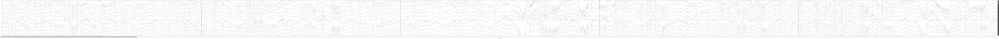

    Using multitaper spectrum estimation with 7 DPSS windows
Plotting power spectral density (dB=True).
Averaging across epochs before plotting...


c:\Users\RAZER\anaconda3\envs\torch_on\lib\site-packages\mne\viz\utils.py:158: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


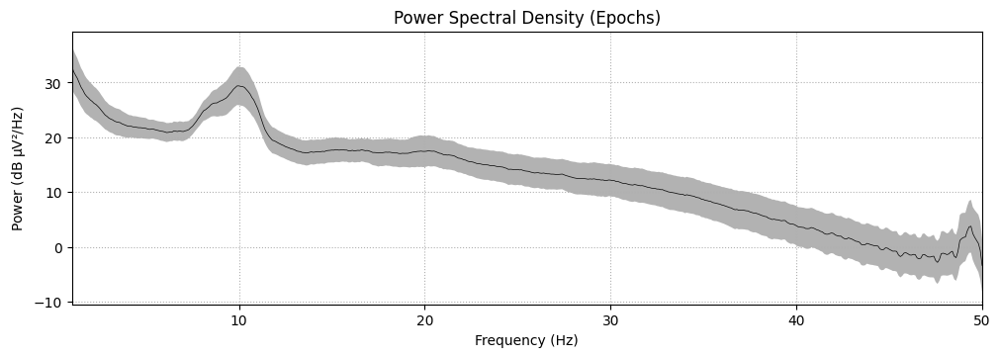


Events Detected:
[[    1     0     1]
 [ 2501     0     2]
 [ 5001     0     2]
 [ 7501     0     2]
 [10001     0     2]
 [12501     0     2]
 [15001     0     2]
 [17501     0     2]
 [20001     0     2]
 [22501     0     2]
 [25001     0     2]
 [27501     0     2]
 [30001     0     2]
 [32501     0     2]
 [35001     0     2]
 [37501     0     2]
 [40001     0     2]
 [42501     0     2]
 [45001     0     2]
 [47501     0     2]
 [50001     0     2]
 [52501     0     2]
 [55001     0     2]
 [57501     0     2]
 [60001     0     2]
 [62501     0     2]
 [65001     0     2]
 [67501     0     2]
 [70001     0     2]
 [72501     0     2]
 [75001     0     2]
 [77501     0     2]
 [80001     0     2]
 [82501     0     2]
 [85001     0     2]
 [87501     0     2]
 [90001     0     3]]

Event Dictionary:
{'EVNT/comm/EVNT': 1, 'EVNT/EVNT': 2, 'EVNT': 3}


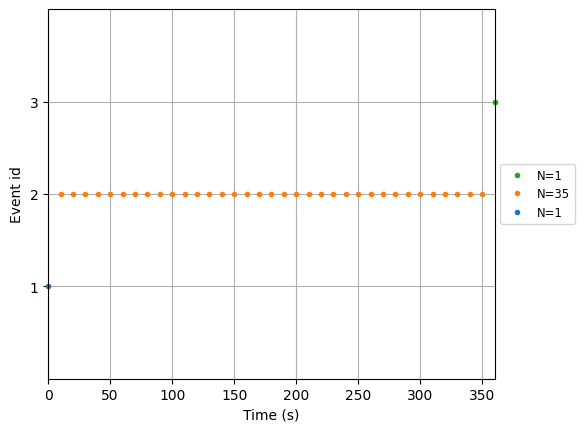

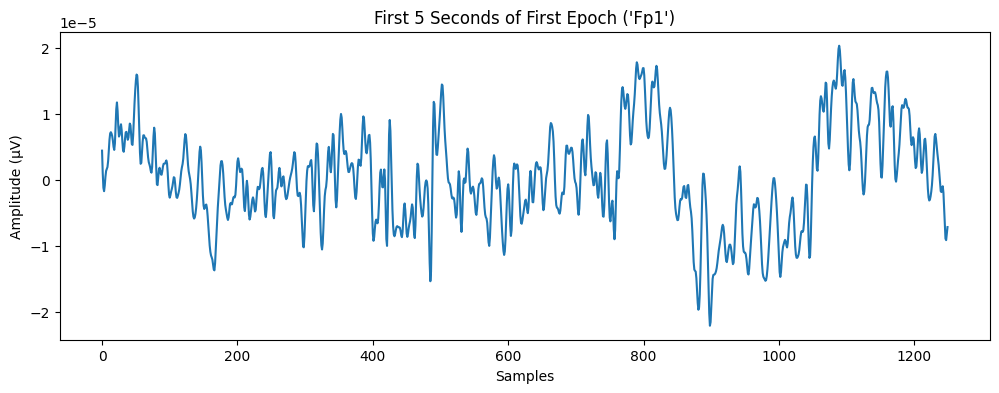


Epoch processing complete. Data saved as 'processed_epochs-epo.fif'.


In [7]:
import mne
import matplotlib.pyplot as plt

# Set the path to your .set file
set_file = r"C:\Users\RAZER\Documents\Datasets\NYC\EEG_250517\EEG\EEG\28-2010-anest 20100824 092.004.set"

# Load the epochs from the .set file
epochs = mne.io.read_epochs_eeglab(set_file, verbose=True)

# Print basic info about the epochs
print("\nEpochs Information:")
print(epochs.info)  # Detailed metadata
print("\nEpochs Shape (Epochs x Channels x Samples):")
print(epochs.get_data().shape)  # Data dimensions

# Plot a sample of the epochs data
epochs.plot(n_epochs=5, n_channels=10, scalings='auto', title='Sample Epochs', show=True)

# Compute and plot Power Spectral Density (PSD)
psd = epochs.compute_psd(fmin=1, fmax=50, method='multitaper')
psd.plot(average=True, show=True)
plt.title("Power Spectral Density (Epochs)")
plt.show()

# Extract event labels and counts
events = epochs.events
event_dict = epochs.event_id

print("\nEvents Detected:")
print(events)
print("\nEvent Dictionary:")
print(event_dict)

# Plot the event timeline (no need for first_samp here)
mne.viz.plot_events(events, sfreq=epochs.info['sfreq'], show=True)

# Extract and plot the first 5 seconds of a specific epoch and channel (e.g., 'Fp1')
first_epoch_data = epochs.get_data()[0, 0, :int(epochs.info['sfreq'] * 5)]
plt.figure(figsize=(12, 4))
plt.plot(first_epoch_data)
plt.title("First 5 Seconds of First Epoch ('Fp1')")
plt.xlabel("Samples")
plt.ylabel("Amplitude (µV)")
plt.show()

# Save the preprocessed epochs for future analysis
epochs.save('processed_epochs-epo.fif', overwrite=True)

print("\nEpoch processing complete. Data saved as 'processed_epochs-epo.fif'.")


In [8]:
import mne

# Set the path to your .set file
set_file = r"C:\Users\RAZER\Documents\Datasets\NYC\EEG_250517\EEG\EEG\28-2010-anest 20100824 092.004.set"

# Load the epochs from the .set file
epochs = mne.io.read_epochs_eeglab(set_file, verbose=True)

# Save to .fif
epochs.save("processed_epochs-epo.fif", overwrite=True)

print("\nData successfully saved as 'processed_epochs-epo.fif'.")


c:\Users\RAZER\anaconda3\envs\torch_on\lib\site-packages\pymatreader\utils.py:168: UserWarning: Complex objects (like classes) are not supported. They are imported on a best effort base but your mileage will vary.
  warn(


Extracting parameters from C:\Users\RAZER\Documents\Datasets\NYC\EEG_250517\EEG\EEG\28-2010-anest 20100824 092.004.set...
Not setting metadata
37 matching events found
No baseline correction applied
0 projection items activated
Ready.
Overwriting existing file.
Overwriting existing file.


C:\Users\RAZER\AppData\Local\Temp\ipykernel_32088\3936325135.py:7: RuntimeWarning: At least one epoch has multiple events. Only the latency of the first event will be retained.
  epochs = mne.io.read_epochs_eeglab(set_file, verbose=True)
C:\Users\RAZER\AppData\Local\Temp\ipykernel_32088\3936325135.py:7: RuntimeWarning: Unknown types found, setting as type EEG:
ref: ['Cz']
  epochs = mne.io.read_epochs_eeglab(set_file, verbose=True)



Data successfully saved as 'processed_epochs-epo.fif'.


Reading c:\Users\RAZER\Documents\GitHub_2\NYC_Research_Cell\NEW_EEG_Project_250517\processed_epochs-epo.fif ...
    Found the data of interest:
        t =       0.00 ...    9996.00 ms
        0 CTF compensation matrices available
Not setting metadata
37 matching events found
No baseline correction applied
0 projection items activated

Basic Info:
<Info | 10 non-empty values
 bads: []
 ch_names: E2, E3, E4, E5, E6, E7, Fp2, E10, Fz, E12, E13, E15, E16, E18, ...
 chs: 91 EEG
 custom_ref_applied: False
 dig: 94 items (3 Cardinal, 91 EEG)
 file_id: 4 items (dict)
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: unspecified
 meas_id: 4 items (dict)
 nchan: 91
 projs: []
 sfreq: 250.0 Hz
>

Data Shape (Epochs x Channels x Samples):
(37, 91, 2500)


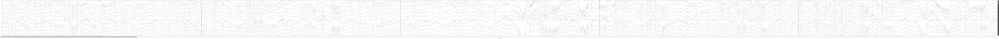

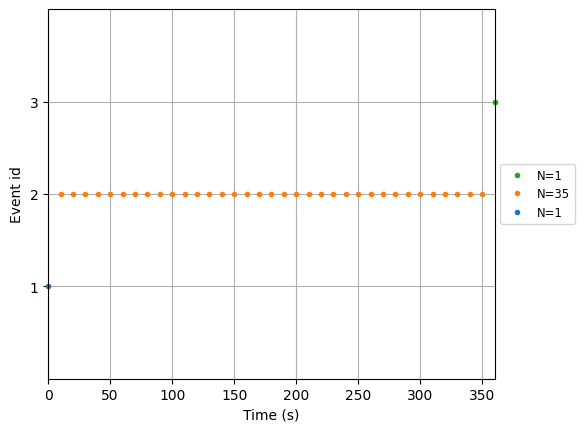

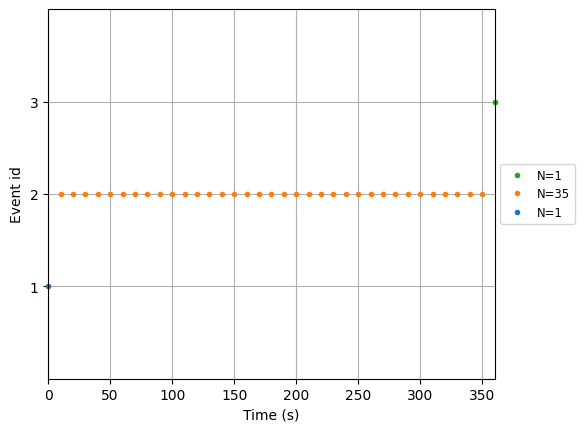

In [9]:
import mne

# Load the newly saved .fif file
epochs = mne.read_epochs("processed_epochs-epo.fif", preload=True)

# Print basic information
print("\nBasic Info:")
print(epochs.info)

# Print the shape of the data
print("\nData Shape (Epochs x Channels x Samples):")
print(epochs.get_data().shape)

# Plot the epochs
epochs.plot(n_epochs=5, n_channels=10, scalings='auto', title='Sample Epochs', show=True)

# Plot the event markers
mne.viz.plot_events(epochs.events, sfreq=epochs.info['sfreq'], show=True)
